In [1]:
!pip install opencv-python

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
!pip3 install torch torchvision torchaudio

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [3]:
!pip install easyocr

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 70.8 MB 27 kB/s 
     |████████████████████████████████| 47.6 MB 93 kB/s 
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.6.0.66
    Uninstalling opencv-python-headless-4.6.0.66:
      Successfully uninstalled opencv-python-headless-4.6.0.66


Note: we need PyTorch because the deep learning framework of easyocr is built using PyTorch.

In [47]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import cv2
import easyocr

# Load Images

In [85]:
carplate_img = 'CarPlate.jpg'
handwriting1_ing = 'HandWriting1.jpg'
digits1_img = 'digits1.jpg'
digits2_img = 'digits2.jpg'
invoice_img = 'invoice.png'
notice1_img = 'notice1.jpg'
notice2_img = 'notice2.jpg'

# Extract text using Easyocr

In [41]:
def recognize_text(img_path):
  #load images
  reader = easyocr.Reader(['en']) #detect only english texts
  #recognize text
  return reader.readtext(img_path)

In [42]:
carplate = recognize_text(carplate_img)

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:253: UserWarning: Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will be removed in 0.15. Please access them via the appropriate Weights Enum instead.
  "Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


In [43]:
# It returns a list of 4 positions of the text detected, 
# text of the image, confidence(accuracy of each twxt detectd)
carplate

[([[1522, 4139], [2202, 4139], [2202, 4313], [1522, 4313]],
  'CCC 444',
  0.5483491639638102),
 ([[1636, 4300], [2011, 4300], [2011, 4351], [1636, 4351]],
  'T E $ L A . C 0 M',
  0.3179948367093998),
 ([[2519, 4358], [2635, 4358], [2635, 4388], [2519, 4388]],
  'DIAL',
  0.8864825367927551),
 ([[2644, 4362], [2790, 4362], [2790, 4388], [2644, 4388]],
  'MotoR',
  0.605705206898923)]

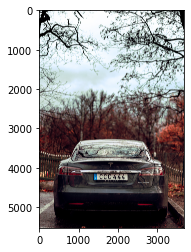

In [44]:
# Check accuracy by displaying the original image
carplate_original = cv2.imread(carplate_img)
carplate_original = cv2.cvtColor(carplate_original, cv2.COLOR_BGR2RGB)
plt.imshow(carplate_original)

In [82]:
# Function to draw a rectangle around each recognized text
def overlay_ocr_text(img_path, save_as_name):
  #Load images
  img = cv2.imread(img_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # Define dots per inch of the image
  dpi = 80
  #speciy the figure width and height
  fig_width, fig_height = int(img.shape[0]/dpi), int(img.shape[1]/dpi)
  plt.figure()
  f, axarr = plt.subplots(1, 2, figsize = (fig_width, fig_height))
  axarr[0].imshow(img)  #display the original image on the left side

  # Recognize text
  result_img = recognize_text(img_path)  

  # If OCR Confidence > 0.5, draw bounding box and text
  for(b_box, text, prob) in result_img:
      if prob >= 0.5:
        #display the box
        print(f'Detected text: {text} (Probability: {prob:.2f})')

        # Get top-left and bottom-right b_box vertices
        (top_left, top_right, bottom_right, bottom_left) = b_box
        top_left = (int(top_left[0]), int(top_left[1]))
        bottom_right = (int(bottom_right[0]), int(bottom_right[1]))

        # Create a rectangle for b_box display
        cv2.rectangle(img = img, pt1 = top_left, pt2 = bottom_right, 
                      color = (255, 0, 0), thickness = 10)
        
        # Put recognized text
        cv2.putText(img = img, text = text, org = (top_left[0], top_left[1] - 10),
                    fontFace = cv2.FONT_HERSHEY_SIMPLEX, fontScale = 1, 
                    color = (255, 0, 0), thickness = 8)
        
  # show and save image
  axarr[1].imshow(img)
  #plt.savefig(f'./output/{save_as_name}', bbox_inches='tight')

# See output

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:253: UserWarning: Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will be removed in 0.15. Please access them via the appropriate Weights Enum instead.
  "Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Detected text: CCC 444 (Probability: 0.55)
Detected text: DIAL (Probability: 0.89)
Detected text: MotoR (Probability: 0.61)


<Figure size 576x1152 with 0 Axes>

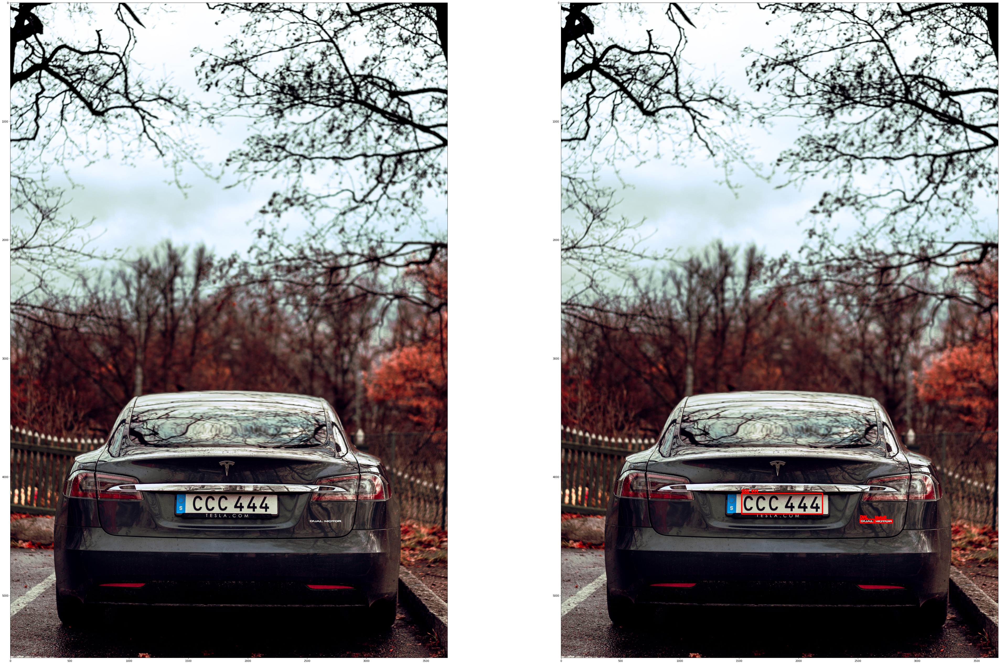

In [83]:
overlay_ocr_text(carplate_img, 'text_carplate')

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:253: UserWarning: Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will be removed in 0.15. Please access them via the appropriate Weights Enum instead.
  "Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Detected text: v (Probability: 0.82)
Detected text: day (Probability: 0.51)
Detected text: 've (Probability: 0.64)
Detected text: You (Probability: 1.00)
Detected text: Gonna (Probability: 0.86)


<Figure size 576x1152 with 0 Axes>

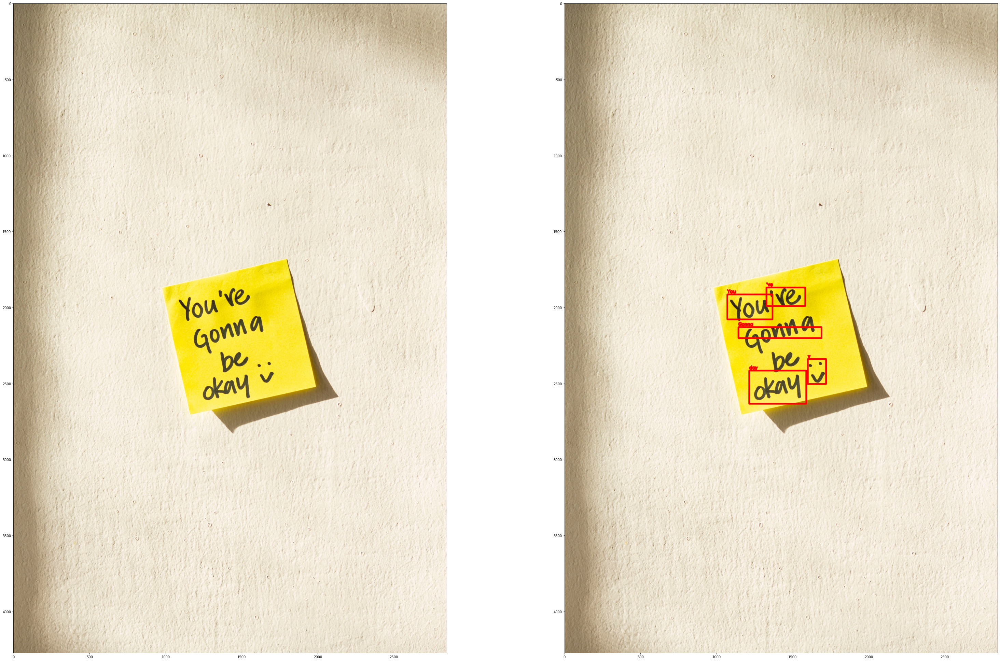

In [86]:
overlay_ocr_text(handwriting1_ing, 'text_HandWriting_1')

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:253: UserWarning: Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will be removed in 0.15. Please access them via the appropriate Weights Enum instead.
  "Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Detected text: 2 (Probability: 1.00)
Detected text: 3 (Probability: 1.00)
Detected text: 5 (Probability: 1.00)
Detected text: 6 (Probability: 1.00)
Detected text: 3 (Probability: 1.00)


<Figure size 576x1152 with 0 Axes>

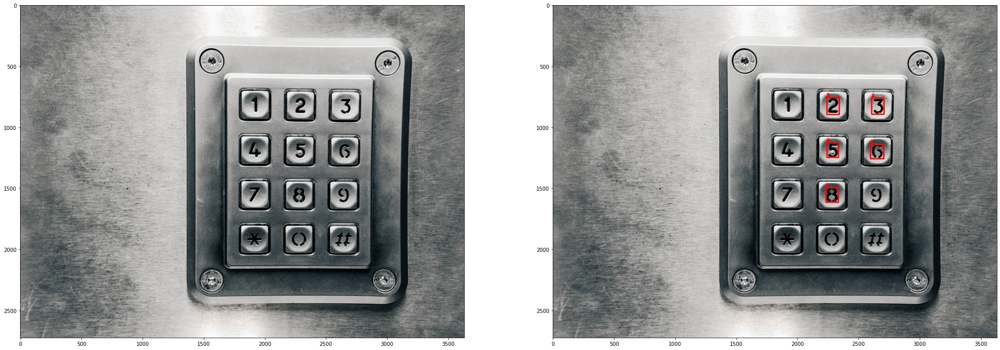

In [88]:
overlay_ocr_text(digits1_img, 'text_digits_1')

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:253: UserWarning: Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will be removed in 0.15. Please access them via the appropriate Weights Enum instead.
  "Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Detected text: 90 (Probability: 0.85)
Detected text: 34 (Probability: 0.61)
Detected text: 5 (Probability: 1.00)
Detected text: 7 (Probability: 1.00)
Detected text: 8 (Probability: 1.00)
Detected text: 2 (Probability: 1.00)
Detected text: 3 (Probability: 1.00)


<Figure size 576x1152 with 0 Axes>

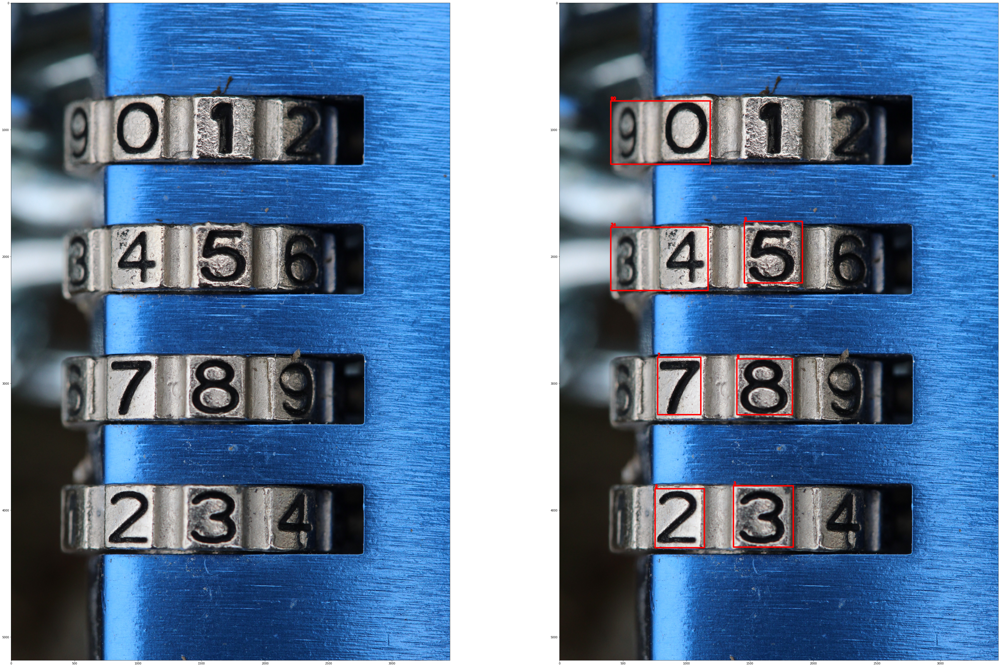

In [89]:
overlay_ocr_text(digits2_img, 'text_digits_2')

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:253: UserWarning: Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will be removed in 0.15. Please access them via the appropriate Weights Enum instead.
  "Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Detected text: INVOICE (Probability: 1.00)
Detected text: LOGO (Probability: 0.96)
Detected text: East Repair Inc: (Probability: 0.87)
Detected text: 1912 Harvest Lane (Probability: 0.64)
Detected text: New York; NY 12210 (Probability: 0.82)
Detected text: BILL TO (Probability: 0.95)
Detected text: SHIP TO (Probability: 0.98)
Detected text: INVOICE # (Probability: 1.00)
Detected text: US-001 (Probability: 0.74)
Detected text: John Smith (Probability: 0.96)
Detected text: John Smith (Probability: 1.00)
Detected text: INVOICE DATE (Probability: 0.99)
Detected text: 11/02/2019 (Probability: 1.00)
Detected text: 2 Court Square (Probability: 0.57)
Detected text: 3787 Pineview Drive (Probability: 0.65)
Detected text: PO.# (Probability: 0.63)
Detected text: 2312/2019 (Probability: 1.00)
Detected text: New York; NY 12210 (Probability: 0.62)
Detected text: Cambridge (Probability: 1.00)
Detected text: MA 12210 (Probability: 1.00)
Detected text: DUE DATE (Probability: 0.83)
Detected text: 26/02/2

<Figure size 576x1152 with 0 Axes>

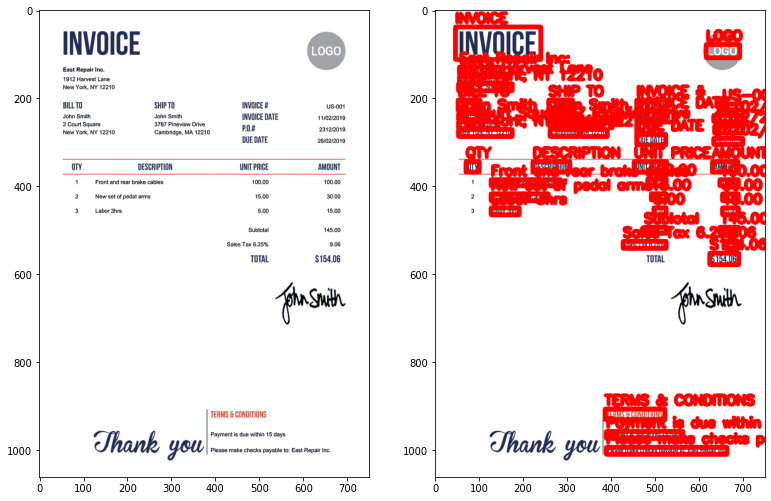

In [90]:
overlay_ocr_text(invoice_img, 'text_invoice')

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:253: UserWarning: Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will be removed in 0.15. Please access them via the appropriate Weights Enum instead.
  "Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Detected text: NOTICE (Probability: 1.00)
Detected text: THANK YOU FOR (Probability: 0.90)
Detected text: NOTICING (Probability: 0.85)
Detected text: THIS NOTICE (Probability: 1.00)
Detected text: YOUR NOTING IT HAS BEEN NOTED (Probability: 0.98)
Detected text: AND IT HAS BEEN REPORTED TO THE AUTHORITIES (Probability: 0.87)


<Figure size 576x1152 with 0 Axes>

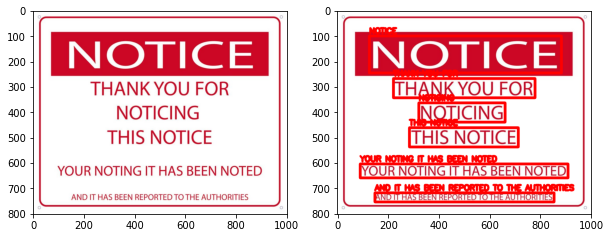

In [91]:
overlay_ocr_text(notice1_img, 'text_notice_1')

/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:253: UserWarning: Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will be removed in 0.15. Please access them via the appropriate Weights Enum instead.
  "Accessing the model URLs via the internal dictionary of the module is deprecated since 0.13 and will "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:209: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  f"The parameter '{pretrained_param}' is deprecated since 0.13 and will be removed in 0.15, "
/usr/local/lib/python3.7/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


Detected text: (School name) (Probability: 0.97)
Detected text: NOTICE (Probability: 1.00)
Detected text: (Date-XXIXXIXXXX) (Probability: 0.98)
Detected text: Tree Plantation Camp (Probability: 0.87)
Detected text: Our school is organizing a tree plantation camp on XXIXXIXXXX For this initiative; we (Probability: 0.71)
Detected text: are (Probability: 1.00)
Detected text: inviting all our students and staff members to be a part of this plantation camp to (Probability: 0.67)
Detected text: make it successful and great: The school will provide saplings of neem; banyan; and (Probability: 0.80)
Detected text: eucalyptus to be planted in and around the school campus. Interested members can (Probability: 0.65)
Detected text: bring the saplings of their choices_ (Probability: 0.91)
Detected text: If you have any further doubts, you may contact the undersigned: (Probability: 0.57)
Detected text: (Name) (Probability: 1.00)
Detected text: (Signature) (Probability: 1.00)
Detected text: (Designati

<Figure size 576x1152 with 0 Axes>

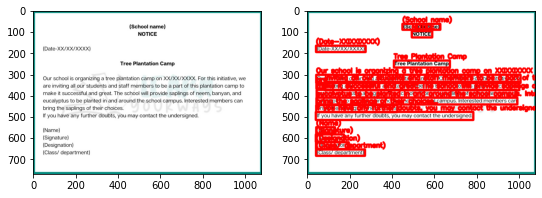

In [92]:
overlay_ocr_text(notice2_img, 'text_invoice_2')